# Collect and check birdsongs data from xenocanto

In [84]:
import pandas as pd
import numpy as np
import os
import requests
import time
from datetime import date 
import matplotlib.pyplot as plt
#import descartes
import geopandas as gpd
#from shapely.geometry import Point, Polygon

Create directory structure

In [18]:
home_path = os.path.abspath('.')
figures_path = os.path.join(home_path, 
                                'figures')
data_path = os.path.join(home_path, 
                                'data')

#os.mkdir(figures_path)
#os.mkdir(data_path)


In [19]:
data_path

'/Users/rubencito/p_experimental/Venezuelan_birds/data'

In [2]:
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela"

In [3]:
my_request = requests.get(my_home_url)

In [4]:
pd.json_normalize(my_request.json())

,numRecordings,numSpecies,page,numPages,recordings
0,7738,958,1,16,"[{'id': '231261', 'gen': 'Tinamus', 'sp': 'tao..."


## Importing the raw data
Create a loop to navigate and retrieve all pages from Venezuela (16) and export the data to a csv local file

In [61]:
n_pages = 16
frames= []
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela&page=" 

for i in range(n_pages):
    my_request = requests.get(my_home_url + str(i+1))
    frames.append(pd.json_normalize(my_request.json(), record_path='recordings'))
    time.sleep(0.5)


my_df = pd.concat(frames, ignore_index=True)
del frames

# add a column with the correct species name
my_df['full_sp_name'] = my_df['gen'] + '_' + my_df['sp'] 
my_df['full_ssp_name'] = my_df['gen'] + '_' + my_df['sp'] + '_' + my_df['ssp']

# export the dataframe
my_df.to_csv(os.path.join(data_path, 
                          str(date.today().strftime("%Y%m%d")) + "_" + "raw_data.csv"),
             index=None)
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7738 entries, 0 to 7737
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             7738 non-null   object
 1   gen            7738 non-null   object
 2   sp             7738 non-null   object
 3   ssp            7738 non-null   object
 4   en             7738 non-null   object
 5   rec            7738 non-null   object
 6   cnt            7738 non-null   object
 7   loc            7738 non-null   object
 8   lat            7438 non-null   object
 9   lng            7437 non-null   object
 10  alt            7738 non-null   object
 11  type           7738 non-null   object
 12  url            7738 non-null   object
 13  file           7738 non-null   object
 14  file-name      7738 non-null   object
 15  lic            7738 non-null   object
 16  q              7738 non-null   object
 17  length         7738 non-null   object
 18  time           7738 non-null

## Load the local csv file

In [65]:
my_df = pd.read_csv(os.path.join(data_path,
                        "20210712_raw_data.csv"))
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7738 entries, 0 to 7737
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             7738 non-null   int64  
 1   gen            7738 non-null   object 
 2   sp             7738 non-null   object 
 3   ssp            1252 non-null   object 
 4   en             7738 non-null   object 
 5   rec            7738 non-null   object 
 6   cnt            7738 non-null   object 
 7   loc            7738 non-null   object 
 8   lat            7438 non-null   float64
 9   lng            7437 non-null   float64
 10  alt            7401 non-null   object 
 11  type           7738 non-null   object 
 12  url            7738 non-null   object 
 13  file           7738 non-null   object 
 14  file-name      7738 non-null   object 
 15  lic            7738 non-null   object 
 16  q              7738 non-null   object 
 17  length         7738 non-null   object 
 18  time    

In [63]:
colnames = my_df.columns
colnames

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name'],
      dtype='object')

## Create and export a figure with the frequency of total records (unfiltered) per Specie

In [39]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
my_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path,
                         'Frequency_of_audio_files_per_specie.pdf'),
            format = 'pdf')

In [36]:
fig, ax = plt.subplots(figsize=(50,20), dpi=300)
my_df['rec'].value_counts().plot.bar(ax=ax)
plt.title("list of recorders in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_audio_files_per_recorder.pdf'),
            format = 'pdf')

## Check the quality of the recordings base on their score

<AxesSubplot:>

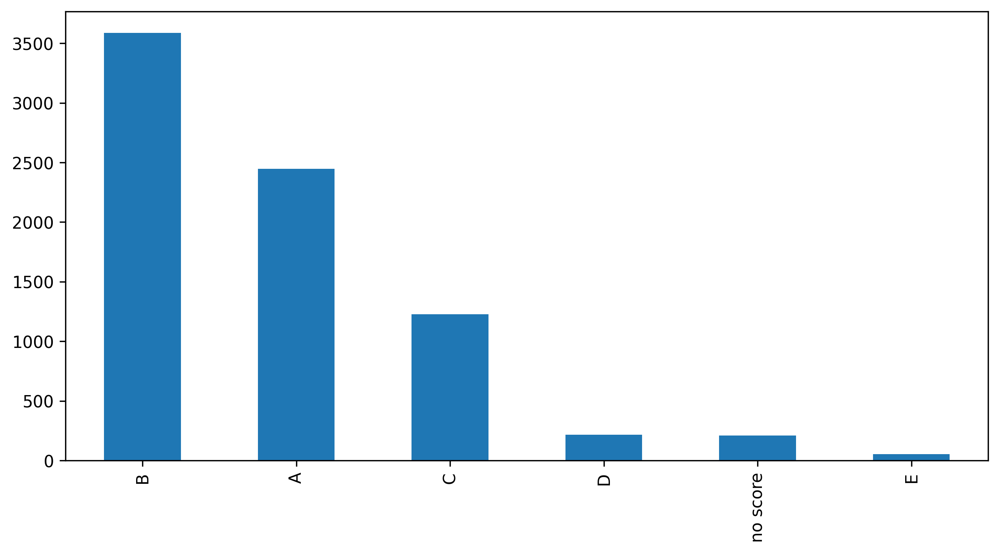

In [59]:
fig, ax = plt.subplots(figsize=(10,5), dpi=300)
my_df['q'].value_counts().plot.bar(ax=ax)

In [48]:
my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6034 entries, 0 to 7724
Data columns (total 29 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             6034 non-null   int64  
 1   gen            6034 non-null   object 
 2   sp             6034 non-null   object 
 3   ssp            1056 non-null   object 
 4   en             6034 non-null   object 
 5   rec            6034 non-null   object 
 6   cnt            6034 non-null   object 
 7   loc            6034 non-null   object 
 8   lat            5814 non-null   float64
 9   lng            5813 non-null   float64
 10  alt            5740 non-null   object 
 11  type           6034 non-null   object 
 12  url            6034 non-null   object 
 13  file           6034 non-null   object 
 14  file-name      6034 non-null   object 
 15  lic            6034 non-null   object 
 16  q              6034 non-null   object 
 17  length         6034 non-null   object 
 18  time    

### Create a DF with "A" & "B" quality files and inspect

In [66]:
A_B_quality_df = my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].reset_index(drop= True)

In [75]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database")
plt.xlabel('Species')
plt.ylabel('number of records')
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_good_audio_files_per_recorder.pdf'),
            format = 'pdf')

In [57]:
fig, ax = plt.subplots(figsize=(50,20), dpi=300)
A_B_quality_df['rec'].value_counts().plot.bar(ax=ax)

<AxesSubplot:>

NOTE: there is an entry called Mystery_mystery repeated quite often.
Lets check it

In [80]:
A_B_quality_df[A_B_quality_df['full_sp_name'].str.contains("Mystery")].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27 entries, 6007 to 6033
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             27 non-null     int64  
 1   gen            27 non-null     object 
 2   sp             27 non-null     object 
 3   ssp            0 non-null      object 
 4   en             27 non-null     object 
 5   rec            27 non-null     object 
 6   cnt            27 non-null     object 
 7   loc            27 non-null     object 
 8   lat            27 non-null     float64
 9   lng            27 non-null     float64
 10  alt            27 non-null     object 
 11  type           27 non-null     object 
 12  url            27 non-null     object 
 13  file           27 non-null     object 
 14  file-name      27 non-null     object 
 15  lic            27 non-null     object 
 16  q              27 non-null     object 
 17  length         27 non-null     object 
 18  time   

In [83]:
A_B_quality_df[(A_B_quality_df['lat'].isna() | A_B_quality_df['lng'].isna())].reset_index(drop= True)

,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,also,rmk,bird-seen,playback-used,sono.small,sono.med,sono.large,sono.full,full_sp_name,full_ssp_name
0,22875,Chauna,chavaria,NaN,Northern Screamer,Alexandre Renaudier,Venezuela,"Zulia, puerta concha",NaN,NaN,...,[''],"one call, repeted 3 times",unknown,unknown,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,Chauna_chavaria,Chauna_chavaria_
1,27867,Penelope,montagnii,NaN,Andean Guan,David Edwards,Venezuela,"Pico Humbolt trail, Parque Nacional Sierra Nev...",NaN,NaN,...,[''],NaN,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,Penelope_montagnii,Penelope_montagnii_
2,22852,Penelope,montagnii,NaN,Andean Guan,Alexandre Renaudier,Venezuela,"Merida, Pico Humboldt trail",NaN,NaN,...,[''],NaN,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,//www.xeno-canto.org/sounds/uploaded/GKADEITXT...,Penelope_montagnii,Penelope_montagnii_
3,221764,Crax,daubentoni,NaN,Yellow-knobbed Curassow,Peter Boesman,Venezuela,"Hato Mataclara, Cojedes",NaN,NaN,...,[''],NaN,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Crax_daubentoni,Crax_daubentoni_
4,10148,Cercibis,oxycerca,NaN,Sharp-tailed Ibis,Andrew Spencer,Venezuela,"Hato El Porvenir, Apure",NaN,NaN,...,[''],calls from three birds sitting on dead snags,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,Cercibis_oxycerca,Cercibis_oxycerca_
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
216,49671,Saltator,coerulescens,NaN,Greyish Saltator,Rosendo Fraga,Venezuela,"Rio Comboto, Aragaua",NaN,NaN,...,[''],<a href=http://www.xeno-canto.org/graphics/con...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/JQSYKZHEM...,//www.xeno-canto.org/sounds/uploaded/JQSYKZHEM...,//www.xeno-canto.org/sounds/uploaded/JQSYKZHEM...,//www.xeno-canto.org/sounds/uploaded/JQSYKZHEM...,Saltator_coerulescens,Saltator_coerulescens_
217,20078,Saltator,orenocensis,NaN,Orinoco Saltator,David Edwards,Venezuela,"South of Coro, Falcon",NaN,NaN,...,[''],NaN,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,//www.xeno-canto.org/sounds/uploaded/AFEHYCAHZ...,Saltator_orenocensis,Saltator_orenocensis_
218,14890,Saltator,orenocensis,rufescens,Orinoco Saltator,Andrew Spencer,Venezuela,Quibor-Sanare Road,NaN,NaN,...,[''],unknown if the first call on the cut is from t...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,//www.xeno-canto.org/sounds/uploaded/CDTGHVBGZ...,Saltator_orenocensis,Saltator_orenocensis_rufescens
219,581868,Sporophila,bouvronides,NaN,Lesson's Seedeater,Francisco contreras,Venezuela,"Cabure, Petit, Falcón",NaN,NaN,...,[''],NaN,yes,no,//www.xeno-canto.org/sounds/uploaded/KSTJLKZWM...,//www.xeno-canto.org/sounds/uploaded/KSTJLKZWM...,//www.xeno-canto.org/sounds/uploaded/KSTJLKZWM...,//www.xeno-canto.org/sounds/uploaded/KSTJLKZWM...,Sporophila_bouvronides,Sporophila_bouvronides_
